In [ ]:
# Instalacion de bibliotecas
! pip install h2o --quiet

In [ ]:
# Importo bibliotecas
import pandas as pd
import numpy as np
import warnings
import h2o

warnings.filterwarnings('ignore')

h2o.init()

In [3]:
# Leemos conjunto de datos de generos por artistas
artists_n_genres = pd.read_csv('https://drive.google.com/uc?export=download&id=1OWTK1QApKhL6VTqwhTPDWU5DNzSPGzeN')
artists_n_genres.head()

,Unnamed: 0,genres,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,popular_genre
0,0,['show tunes'],"""Cats"" 1981 Original London Cast",0.590111,0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5,1,9,show tunes
1,8,"['comedy rock', 'comic', 'parody']","""Weird Al"" Yankovic",0.173145,0.662787,218948.196721,0.695393,0.000050,0.161102,-9.768705,0.084536,133.031180,0.751344,34.229508,9,1,122,comic
2,9,"['emo rap', 'florida rap', 'sad rap', 'undergr...",$NOT,0.544467,0.789800,137910.466667,0.532933,0.023063,0.180300,-9.149267,0.293687,112.344800,0.480700,67.533333,1,1,15,underground hip hop
3,10,"['dark trap', 'meme rap']",$atori Zoom,0.239000,0.883000,141519.000000,0.625000,0.000000,0.076500,-4.098000,0.245000,126.677000,0.871000,67.000000,6,1,2,dark trap
4,12,"['asian american hip hop', 'cali rap', 'west c...",$tupid Young,0.148100,0.854000,190572.000000,0.683000,0.000002,0.188500,-6.997000,0.221000,100.724500,0.625500,57.500000,1,1,2,cali rap


In [4]:
# Borramos columnas que no utilizaremos
artists_n_genres.drop(['genres', 'Unnamed: 0'], axis=1, inplace=True)

In [5]:
# Seleccionamos unicamente generos que aparezcan, por lo menos, mas de 80 veces en todo el conjunto de datos
artists_n_genres = artists_n_genres[artists_n_genres['popular_genre'].map(artists_n_genres['popular_genre'].value_counts()) > 80]

In [6]:
# Definimos variable target a estimar
y = 'popular_genre_code'

In [7]:
# Creamos variable a estimar con el codigo de la categoria de cada genero por registro 
artists_n_genres[y] = artists_n_genres['popular_genre'].astype('category').cat.codes

In [8]:
# Borramos columna popular_genre que ya no nos sera mas de utilidad
artists_n_genres.drop('popular_genre', axis=1, inplace=True)

In [9]:
# Separamos en conjuntos de entrenamiento y testeo
mask = np.random.rand(len(artists_n_genres)) < 0.9
train = artists_n_genres[mask]
test = artists_n_genres[~mask]

In [10]:
# Creamos un h2o dataframe a partir de nuestro conjunto de datos
train = h2o.H2OFrame(train) 
test = h2o.H2OFrame(test) 

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [11]:
# Convertimos variable target a categoria
train[y] = train[y].asfactor()
test[y] = test[y].asfactor()

In [12]:
# Sacamos la columna target del conjunto de entrenamiento
x = train.columns
x.remove(y)

In [13]:
# Entreno modelo de auto machine learning H2O
auto_ml = h2o.automl.H2OAutoML(seed = 10,
                               max_models = 10,
                               max_runtime_secs = 60*60*5,  
                               max_after_balance_size = 5,
                               stopping_rounds = 3,
                               stopping_tolerance = 1e-2,
                               stopping_metric = 'AUC', 
                               sort_metric = 'AUC', 
                               balance_classes = True, 
                               keep_cross_validation_models = True,
                               )

auto_ml.train(x=x, y=y, training_frame=train)

AutoML progress: |███████████████████████████████████████████████
16:45:37.337: StackedEnsemble_BestOfFamily_1_AutoML_1_20211013_130057 [StackedEnsemble best_of_family_1 (built with AUTO metalearner, using top model from each algorithm type)] failed: java.lang.RuntimeException: java.lang.ArrayIndexOutOfBoundsException: Index 139 out of bounds for length 139

███████
17:17:33.999: GBM_3_AutoML_1_20211013_130057 [GBM def_3] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for GBM model: GBM_3_AutoML_1_20211013_130057_cv_1.  Details: ERRR on field: _ntrees: The tree model will not fit in the driver node's memory (62.3 KB per tree x 10000 > 542.8 MB) - try decreasing ntrees and/or max_depth or increasing min_rows!



17:18:04.59: GBM_4_AutoML_1_20211013_130057 [GBM def_4] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for GBM model: GBM_4_AutoML_1_20211013_130057_cv_1.  Details: ERRR on field: _ntrees: The tree mod

In [14]:
# Ranking de los modelos entrenados
leaderboard = auto_ml.leaderboard
leaderboard.head()

model_id,auc,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_AllModels_2_AutoML_1_20211013_130057,nan,0.763144,2.76956,0.857423,0.735175
XGBoost_1_AutoML_1_20211013_130057,nan,0.630168,2.48918,0.763366,0.582728
GBM_1_AutoML_1_20211013_130057,nan,0.693857,10.231,0.788287,0.621396
GBM_2_AutoML_1_20211013_130057,nan,0.670908,2.6387,0.769367,0.591925
GBM_5_AutoML_1_20211013_130057,nan,0.680219,2.61688,0.785397,0.616848
DeepLearning_1_AutoML_1_20211013_130057,nan,0.745251,2.54238,0.849741,0.722059
XRT_1_AutoML_1_20211013_130057,nan,0.727758,8.78595,0.810594,0.657063
XGBoost_3_AutoML_1_20211013_130057,nan,0.620344,2.27834,0.751667,0.565003
DRF_1_AutoML_1_20211013_130057,nan,0.710743,5.81993,0.808414,0.653533
XGBoost_2_AutoML_1_20211013_130057,nan,0.618812,2.33577,0.759036,0.576136


In [26]:
# Obtuvimos que el mejor modelo fue un XGBoost classifier. Por eso mismo, ahora entrenaremos ese modelo en particular
best_model = h2o.estimators.H2OXGBoostEstimator(seed = 10,
                                                nfolds = 5,
                                                stopping_rounds = 3,
                                                stopping_tolerance = 1e-2,
                                                stopping_metric = 'AUC', 
                                                auc_type = "WEIGHTED_OVO",
                                                keep_cross_validation_models = True)

best_model.train(x=x, y=y, training_frame=train)

xgboost Model Build progress: |██████████████████████████████████████████████████| (done) 100%
Model Details
H2OXGBoostEstimator :  XGBoost
Model Key:  XGBoost_model_python_1634130040873_1


Model Summary: 


,,number_of_trees
0,,50.0




ModelMetricsMultinomial: xgboost
** Reported on train data. **

MSE: 0.02904505313692901
RMSE: 0.1704260928875887
LogLoss: 0.15308376852949226
Mean Per-Class Error: 0.0012276278455713786
AUC: 0.9999962453364202
AUCPR: 0.9999977735718177

Multinomial AUC values: 


,type,first_class_domain,second_class_domain,auc
0,0 vs Rest,0,None,1.000000
1,1 vs Rest,1,None,1.000000
2,2 vs Rest,2,None,1.000000
3,3 vs Rest,3,None,1.000000
4,4 vs Rest,4,None,1.000000
5,5 vs Rest,5,None,1.000000
6,6 vs Rest,6,None,1.000000
7,7 vs Rest,7,None,1.000000
8,8 vs Rest,8,None,1.000000
9,9 vs Rest,9,None,1.000000



See the whole table with table.as_data_frame()

Multinomial auc_pr values: 


,type,first_class_domain,second_class_domain,auc_pr
0,0 vs Rest,0,None,1.000000
1,1 vs Rest,1,None,1.000000
2,2 vs Rest,2,None,1.000000
3,3 vs Rest,3,None,1.000000
4,4 vs Rest,4,None,1.000000
5,5 vs Rest,5,None,1.000000
6,6 vs Rest,6,None,1.000000
7,7 vs Rest,7,None,1.000000
8,8 vs Rest,8,None,1.000000
9,9 vs Rest,9,None,1.000000



See the whole table with table.as_data_frame()

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,Error,Rate
0,201.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 201
1,0.0,206.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 206
2,0.0,0.0,79.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 79
3,0.0,0.0,0.0,148.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 148
4,0.0,0.0,0.0,0.0,73.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 73
5,0.0,0.0,0.0,0.0,0.0,107.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 107
6,0.0,0.0,0.0,0.0,0.0,0.0,132.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 132
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,73.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 73
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,121.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 121
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,240.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0 / 240



See the whole table with table.as_data_frame()

Top-10 Hit Ratios: 


,k,hit_ratio
0,1,0.997958
1,2,0.999864
2,3,1.000000
3,4,1.000000
4,5,1.000000
5,6,1.000000
6,7,1.000000
7,8,1.000000
8,9,1.000000
9,10,1.000000



ModelMetricsMultinomial: xgboost
** Reported on cross-validation data. **

MSE: 0.5695970662446997
RMSE: 0.7547165469530265
LogLoss: 2.3555378867673578
Mean Per-Class Error: 0.6240829810066773
AUC: 0.9013636426797929
AUCPR: 0.9022663513577077

Multinomial AUC values: 


,type,first_class_domain,second_class_domain,auc
0,0 vs Rest,0,None,0.935105
1,1 vs Rest,1,None,0.941790
2,2 vs Rest,2,None,0.844047
3,3 vs Rest,3,None,0.865349
4,4 vs Rest,4,None,0.880257
5,5 vs Rest,5,None,0.957102
6,6 vs Rest,6,None,0.876545
7,7 vs Rest,7,None,0.953890
8,8 vs Rest,8,None,0.976422
9,9 vs Rest,9,None,0.965281



See the whole table with table.as_data_frame()

Multinomial auc_pr values: 


,type,first_class_domain,second_class_domain,auc_pr
0,0 vs Rest,0,None,0.543451
1,1 vs Rest,1,None,0.509886
2,2 vs Rest,2,None,0.110163
3,3 vs Rest,3,None,0.183164
4,4 vs Rest,4,None,0.142546
5,5 vs Rest,5,None,0.342043
6,6 vs Rest,6,None,0.374212
7,7 vs Rest,7,None,0.535918
8,8 vs Rest,8,None,0.377717
9,9 vs Rest,9,None,0.676342



See the whole table with table.as_data_frame()

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,Error,Rate
0,110.0,0.0,0.0,3.0,4.0,4.0,0.0,0.0,4.0,1.0,0.0,9.0,2.0,19.0,0.0,2.0,0.0,1.0,11.0,4.0,0.0,0.0,1.0,5.0,1.0,0.0,2.0,5.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,3.0,0.0,0.0,2.0,0.452736,91 / 201
1,0.0,99.0,0.0,12.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2.0,0.0,2.0,1.0,0.0,0.0,1.0,1.0,0.0,2.0,1.0,40.0,0.0,2.0,0.0,2.0,12.0,2.0,6.0,3.0,10.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.519417,107 / 206
2,0.0,0.0,10.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,2.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,6.0,4.0,9.0,0.0,1.0,0.0,5.0,0.0,8.0,1.0,0.0,1.0,1.0,3.0,1.0,8.0,0.0,0.0,0.0,1.0,8.0,2.0,0.873418,69 / 79
3,1.0,21.0,0.0,38.0,2.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,15.0,1.0,5.0,0.0,1.0,3.0,2.0,0.0,0.0,0.0,1.0,5.0,0.0,12.0,1.0,6.0,0.0,1.0,1.0,3.0,6.0,0.0,10.0,2.0,1.0,1.0,0.0,0.0,3.0,2.0,0.0,0.0,1.0,0.743243,110 / 148
4,6.0,0.0,0.0,1.0,10.0,0.0,0.0,3.0,0.0,2.0,0.0,2.0,0.0,8.0,0.0,0.0,0.0,2.0,6.0,5.0,0.0,0.0,0.0,1.0,4.0,3.0,0.0,8.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.863014,63 / 73
5,6.0,0.0,0.0,1.0,1.0,41.0,6.0,1.0,0.0,0.0,0.0,0.0,5.0,8.0,0.0,0.0,0.0,1.0,3.0,1.0,0.0,1.0,0.0,3.0,0.0,6.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,1.0,0.0,3.0,0.0,6.0,0.0,0.0,0.0,8.0,0.616822,66 / 107
6,3.0,1.0,1.0,0.0,0.0,9.0,48.0,0.0,0.0,0.0,3.0,0.0,5.0,2.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0,2.0,9.0,0.0,3.0,0.0,1.0,1.0,6.0,13.0,6.0,2.0,0.0,0.0,1.0,2.0,0.0,1.0,0.0,1.0,3.0,3.0,0.636364,84 / 132
7,2.0,0.0,0.0,1.0,1.0,0.0,0.0,37.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,2.0,1.0,2.0,1.0,5.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,1.0,0.0,5.0,0.0,4.0,0.0,0.0,1.0,0.0,0.0,1.0,0.493151,36 / 73
8,4.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,46.0,46.0,0.0,5.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,2.0,0.0,0.0,0.0,0.619835,75 / 121
9,2.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,38.0,168.0,0.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,1.0,11.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,6.0,0.0,0.0,0.0,0.300000,72 / 240



See the whole table with table.as_data_frame()

Top-10 Hit Ratios: 


,k,hit_ratio
0,1,0.404519
1,2,0.563359
2,3,0.647475
3,4,0.703961
4,5,0.747516
5,6,0.778413
6,7,0.803593
7,8,0.824554
8,9,0.840615
9,10,0.855723



Cross-Validation Metrics Summary: 


,,mean,sd,cv_1_valid,cv_2_valid,cv_3_valid,cv_4_valid,cv_5_valid
0,accuracy,0.404559,0.013432,0.416503,0.389146,0.417627,0.391864,0.407653
1,auc,0.902896,0.001450,0.901011,0.902231,0.904580,0.902554,0.904105
2,err,0.595441,0.013432,0.583497,0.610854,0.582373,0.608136,0.592347
3,err_count,875.000000,45.276924,891.000000,923.000000,859.000000,897.000000,805.000000
4,logloss,2.354867,0.053243,2.328832,2.404232,2.305193,2.420049,2.316030
5,max_per_class_error,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,mean_per_class_accuracy,0.377213,0.014658,0.388712,0.354819,0.391258,0.372217,0.379060
7,mean_per_class_error,0.622787,0.014658,0.611288,0.645181,0.608742,0.627783,0.620940
8,mse,0.569453,0.010082,0.564688,0.584633,0.560339,0.574700,0.562905
9,pr_auc,0.903860,0.002413,0.905261,0.899755,0.905156,0.905515,0.903611



Scoring History: 


,,timestamp,duration,number_of_trees,training_rmse,training_logloss,training_classification_error,training_auc,training_pr_auc
0,,2021-10-13 19:00:01,2 min 58.261 sec,0.0,0.978261,3.828641,0.961209,0.500000,0.500000
1,,2021-10-13 19:00:03,2 min 59.889 sec,1.0,0.875136,2.558253,0.546482,0.939811,0.940494
2,,2021-10-13 19:00:05,3 min 1.657 sec,2.0,0.833830,2.179674,0.475568,0.964569,0.963544
3,,2021-10-13 19:00:14,3 min 10.798 sec,12.0,0.576299,0.922937,0.192460,0.994856,0.994954
4,,2021-10-13 19:00:28,3 min 25.315 sec,34.0,0.287966,0.299148,0.016197,0.999899,0.999932
5,,2021-10-13 19:00:40,3 min 36.824 sec,50.0,0.170426,0.153084,0.002042,0.999996,0.999998



Variable Importances: 


,variable,relative_importance,scaled_importance,percentage
0,popularity,11042.838867,1.000000,0.113306
1,acousticness,10801.466797,0.978142,0.110829
2,speechiness,9795.704102,0.887064,0.100510
3,duration_ms,9429.650391,0.853915,0.096754
4,danceability,9386.182617,0.849979,0.096308
5,loudness,9184.666016,0.831731,0.094240
6,valence,8463.591797,0.766433,0.086841
7,instrumentalness,7866.641602,0.712375,0.080716
8,energy,6590.789551,0.596838,0.067625
9,count,4786.454590,0.433444,0.049112


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## XGBoost_model_python_1634130040873_1


Confusion Matrix: Row labels: Actual class; Column labels: Predicted class


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,Error,Rate
0,13.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.380952,8 / 21
1,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.636364,14 / 22
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.888889,8 / 9
3,0.0,1.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.611111,11 / 18
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.000000,8 / 8
5,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,4 / 8
6,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.583333,7 / 12
7,1.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.636364,7 / 11
8,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.727273,8 / 11
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,10.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500000,10 / 20



See the whole table with table.as_data_frame()


# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

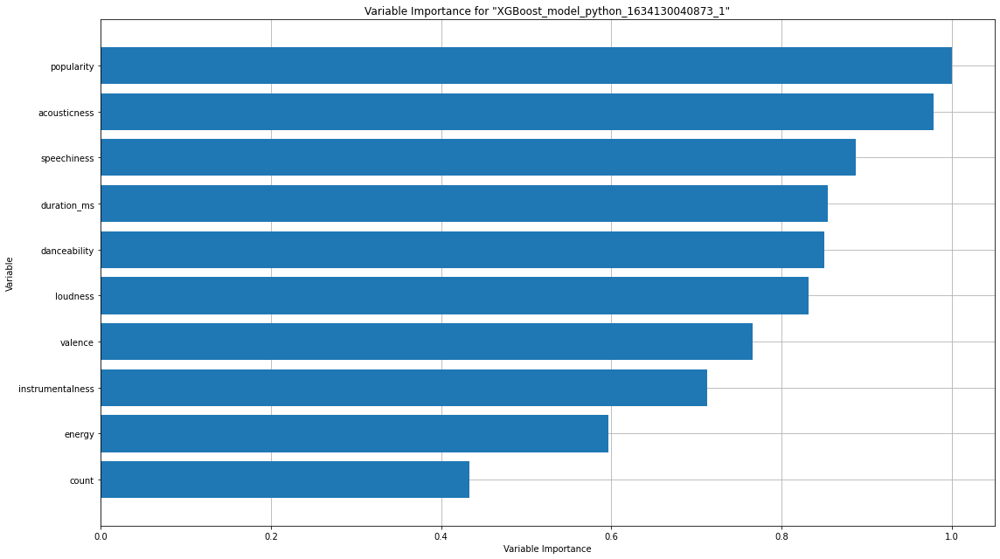

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

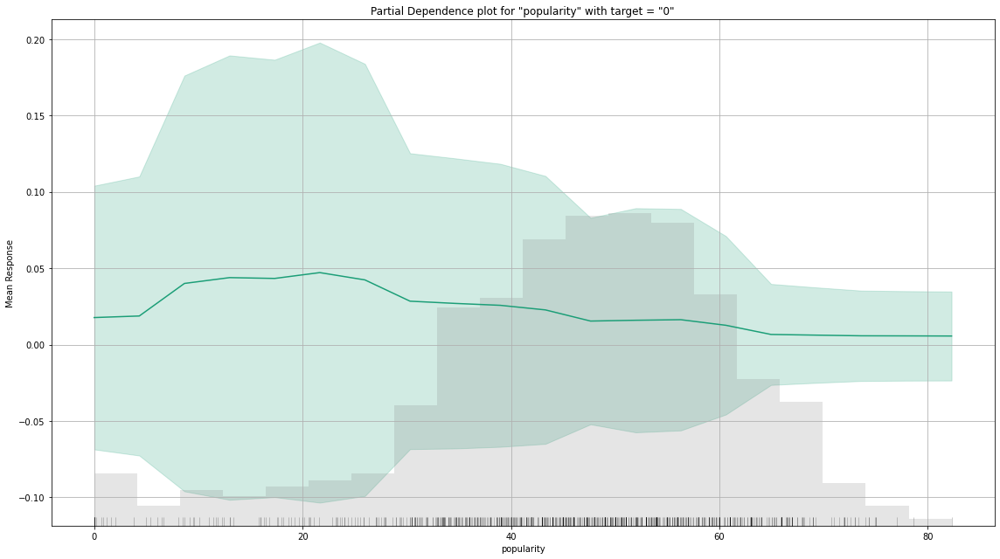

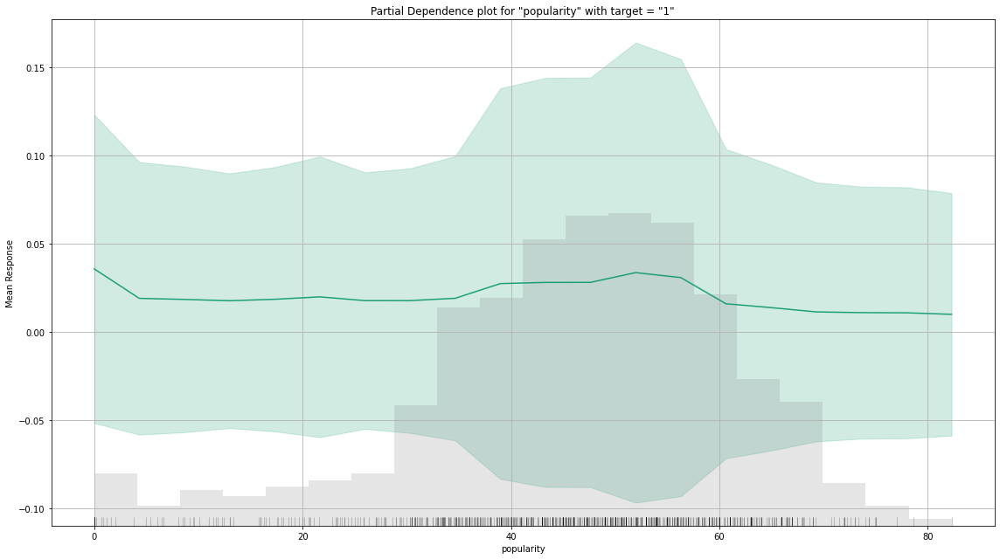

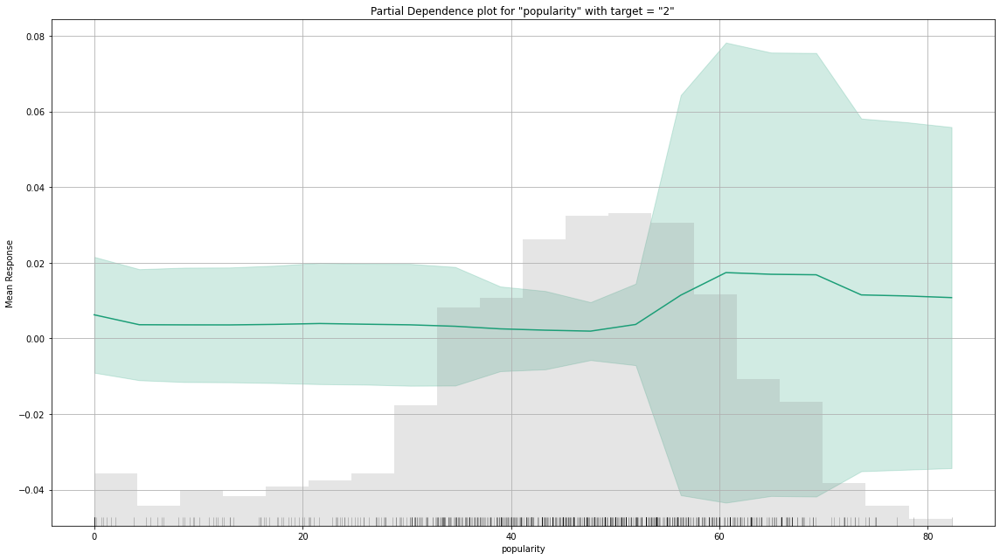

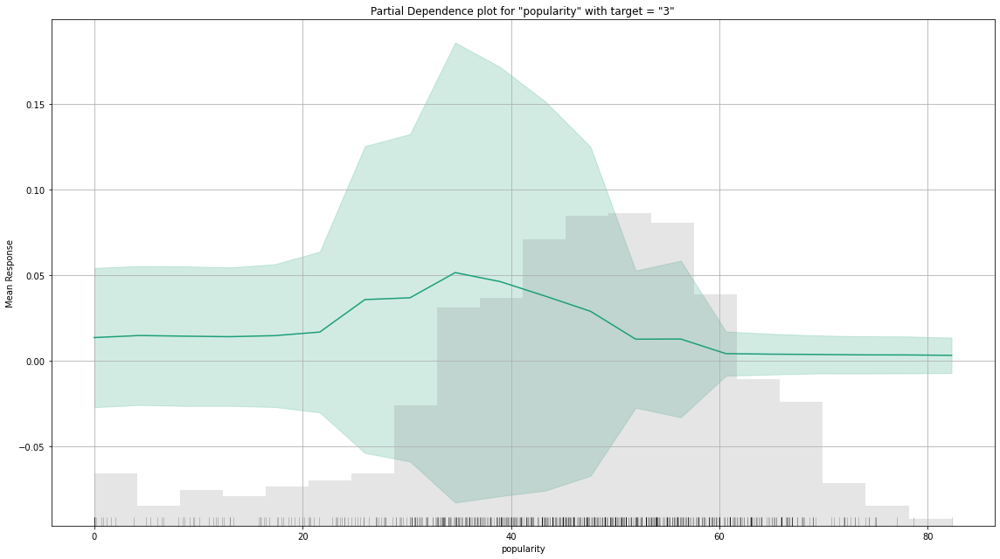

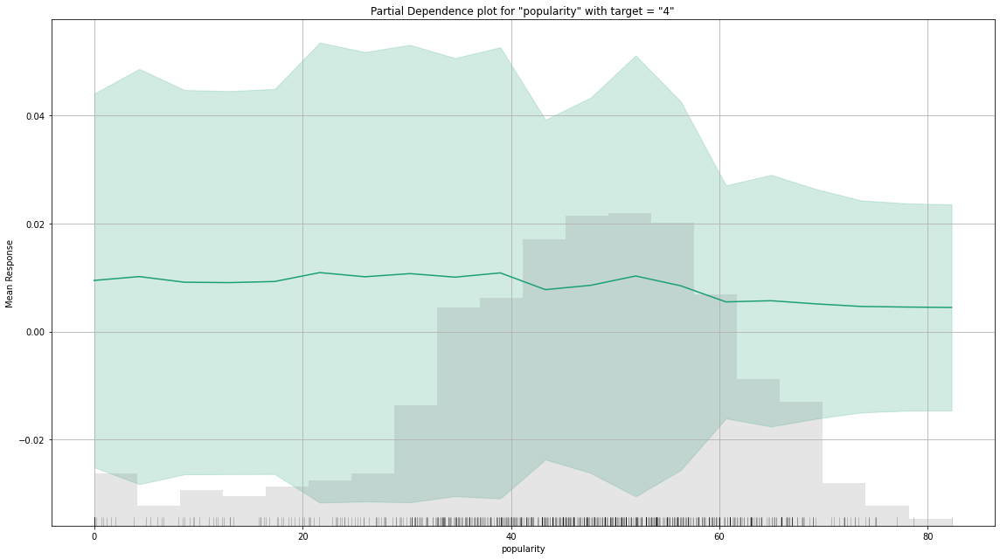

...

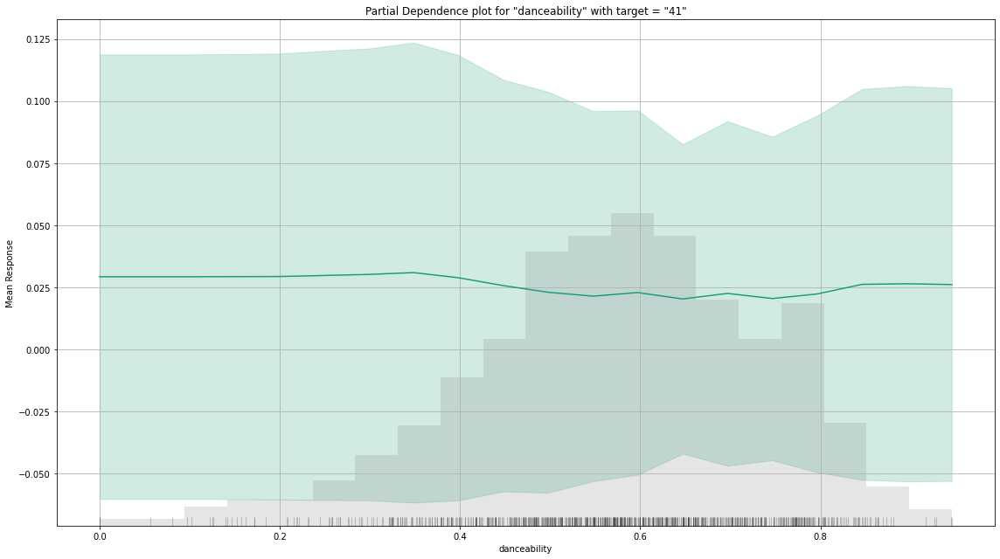

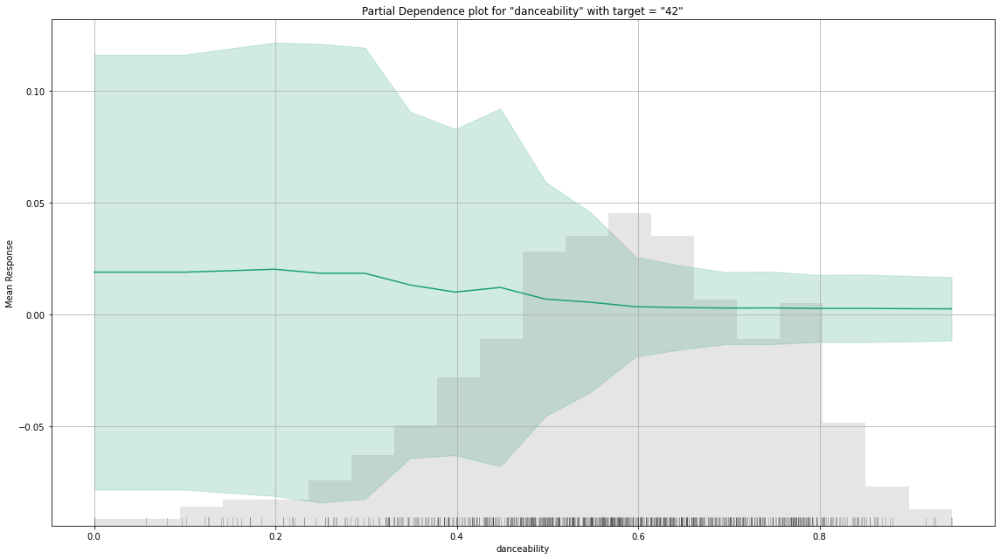

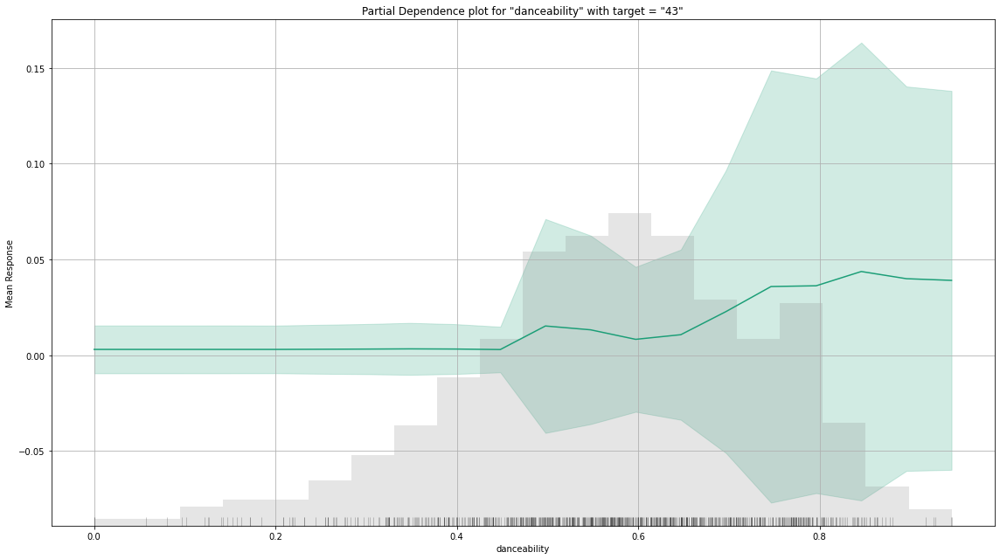

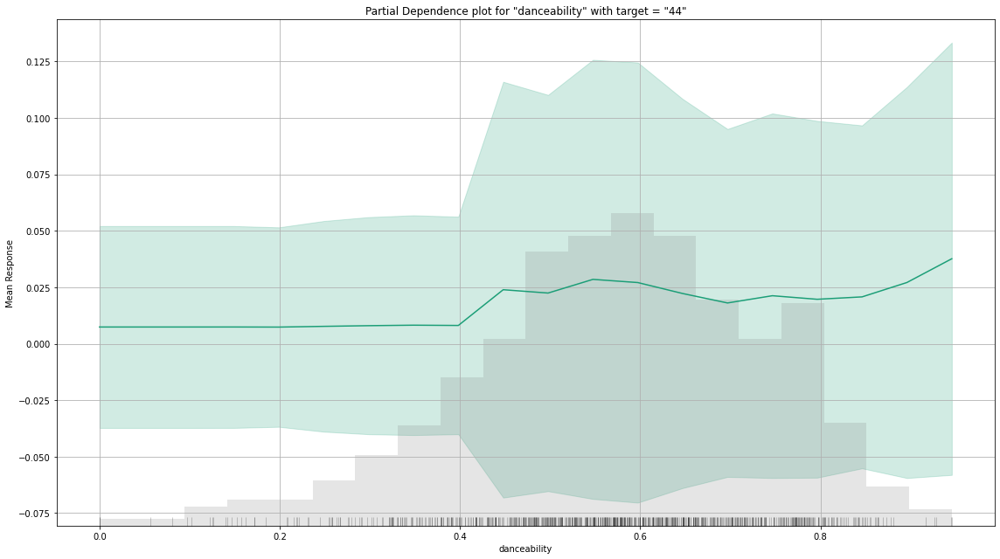

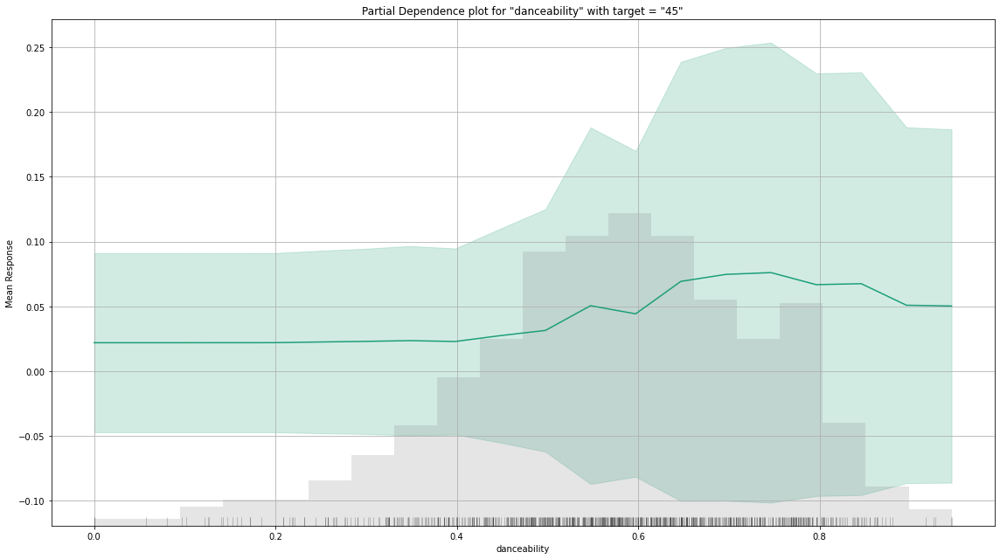

In [28]:
# Descripcion del mejor modelo obtenido
explanation_best_model = best_model.explain(test)

# Individual Conditional Expectation

> Individual conditional expectations (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response for a given row. ICE plot is similar to partial dependence plot (PDP), PDP shows the average effect of a feature while ICE plot shows the effect for a single instance.

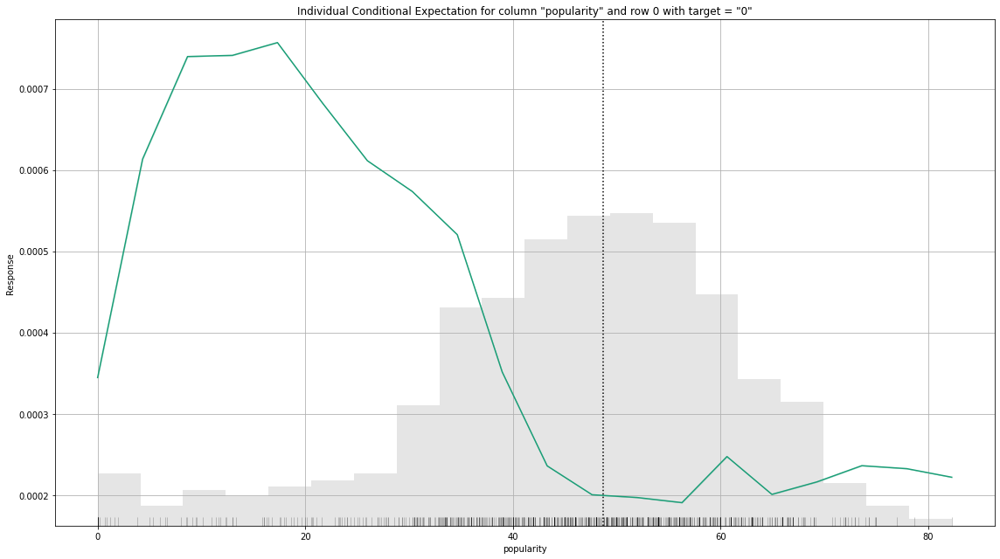

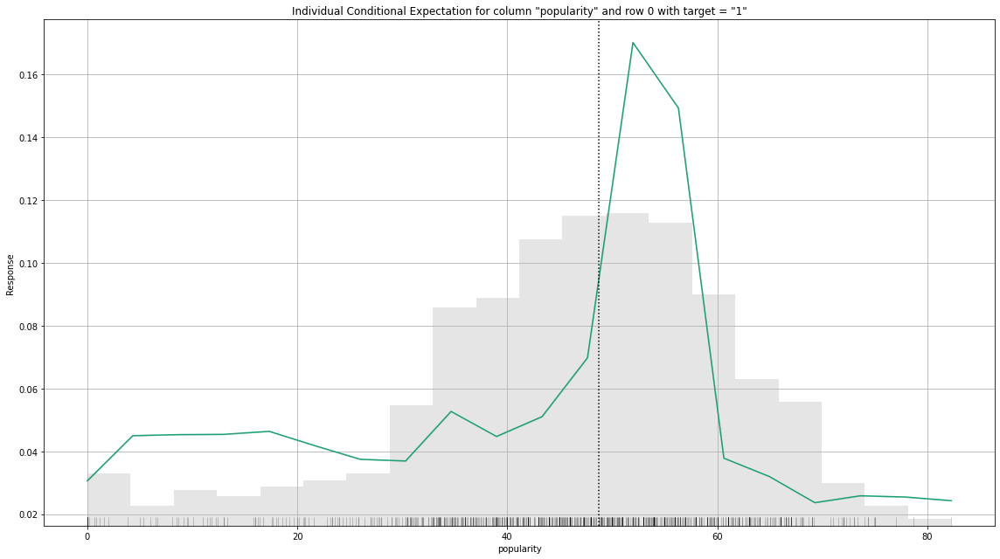

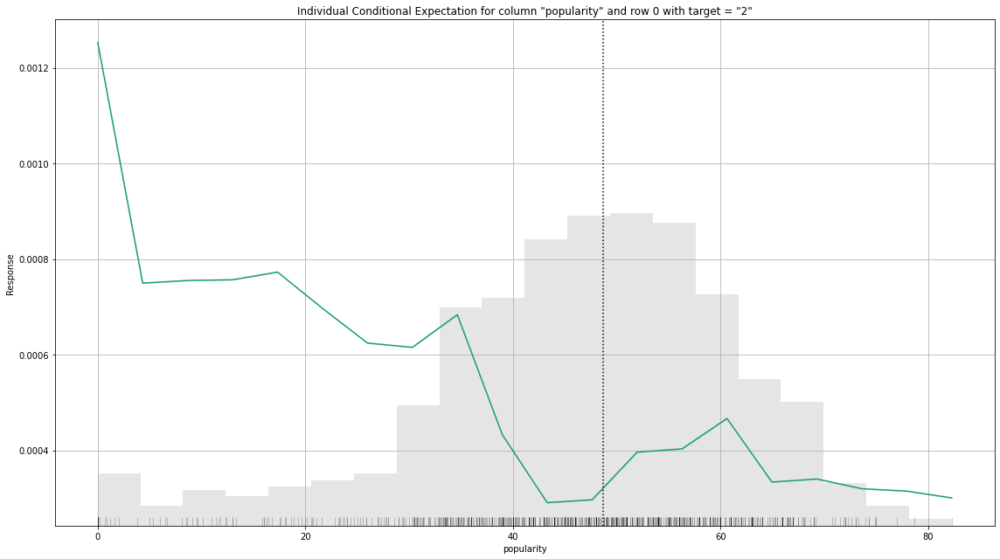

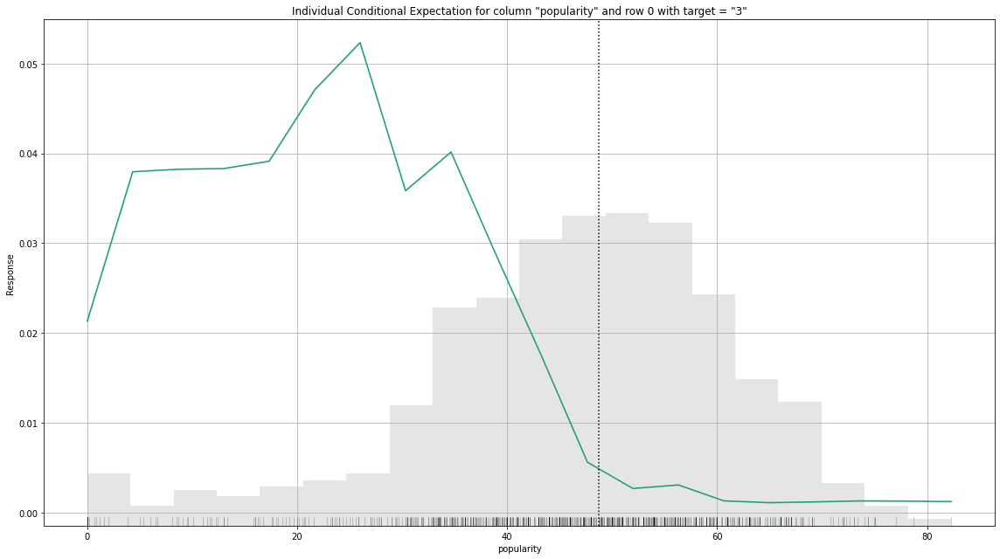

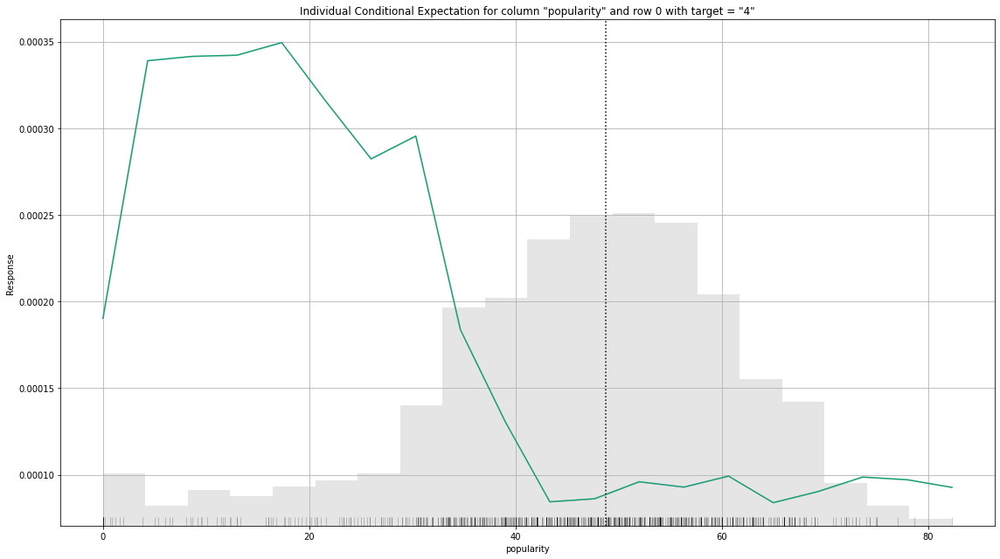

...

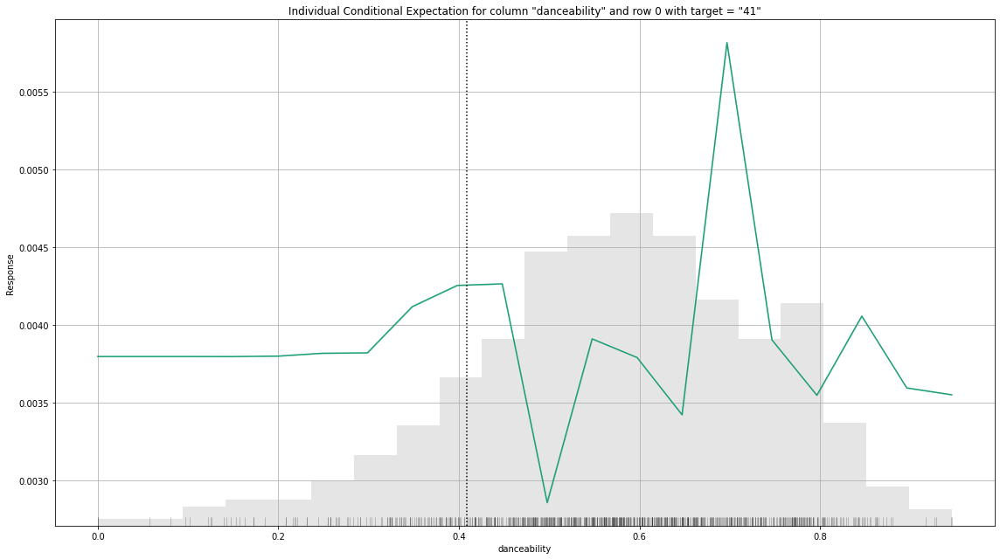

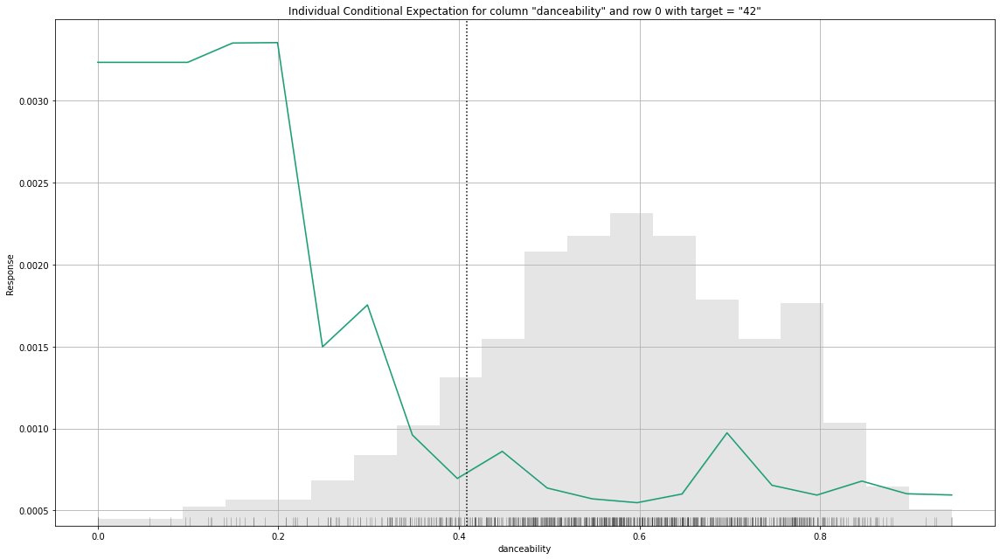

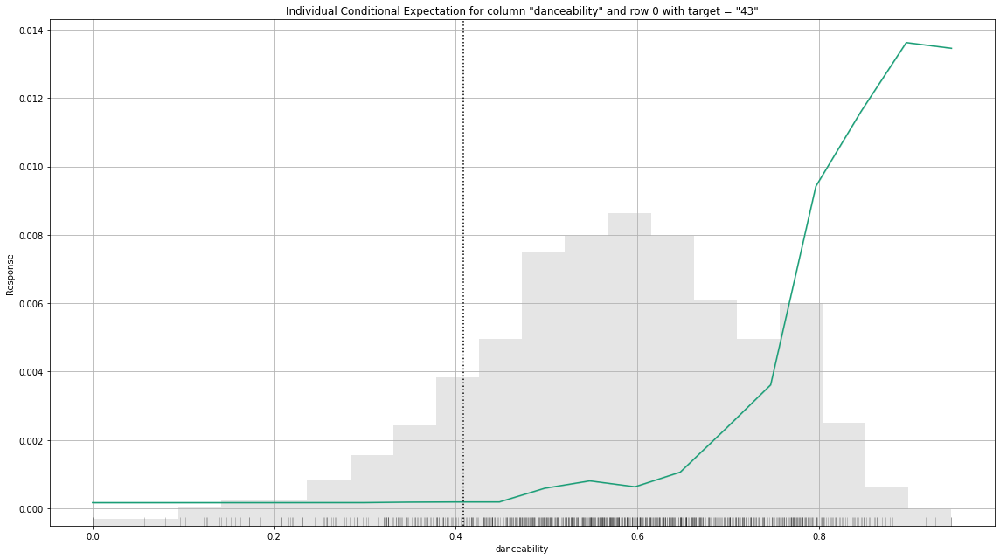

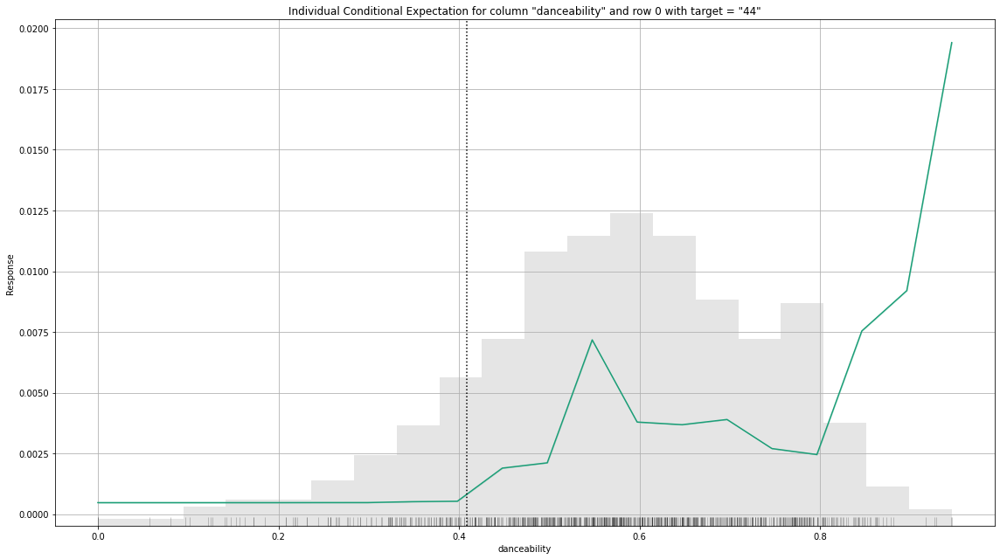

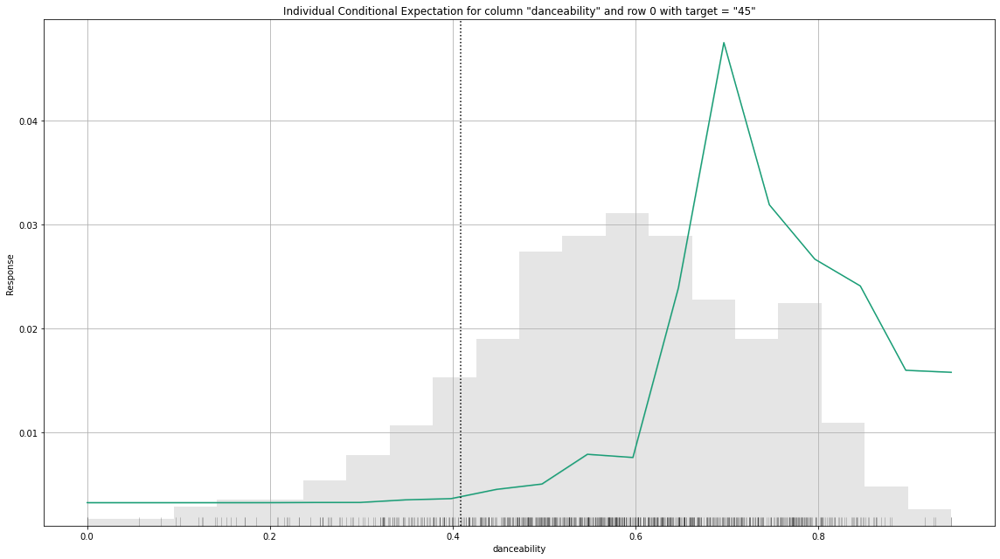

# Individual Conditional Expectation

> Individual conditional expectations (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response for a given row. ICE plot is similar to partial dependence plot (PDP), PDP shows the average effect of a feature while ICE plot shows the effect for a single instance.

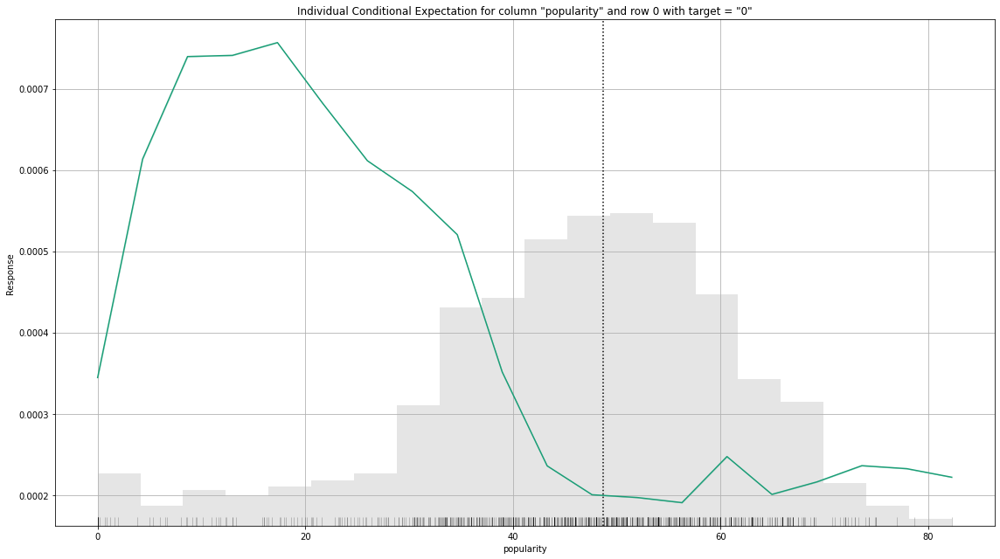

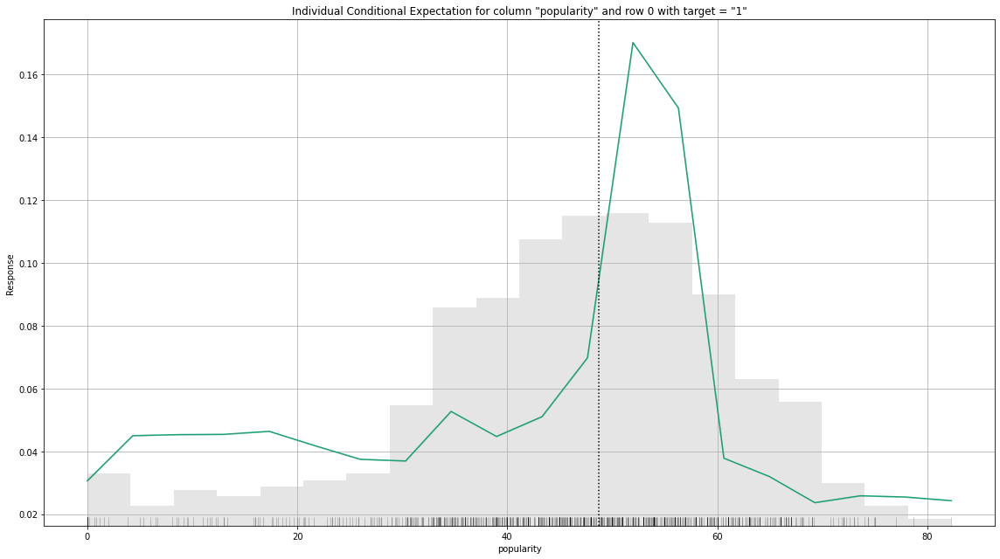

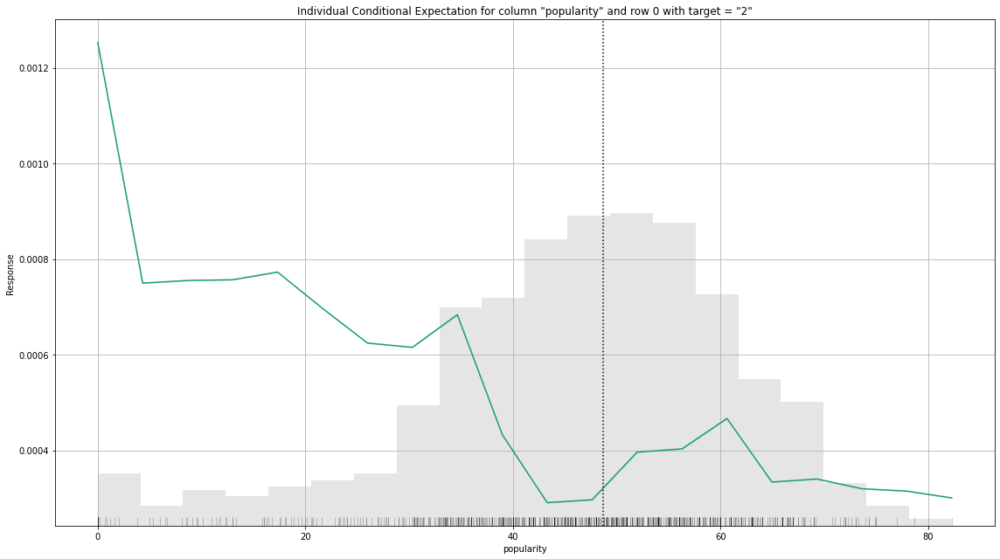

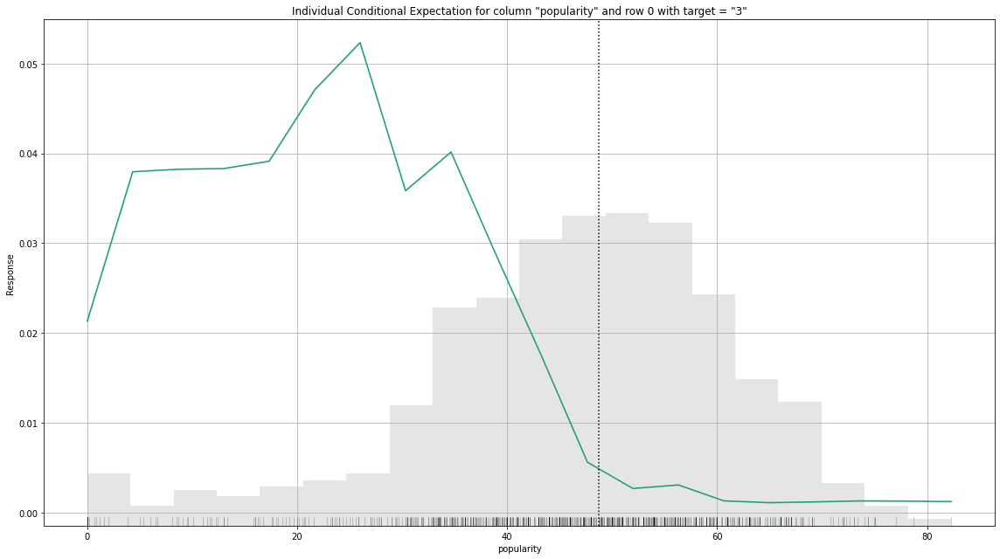

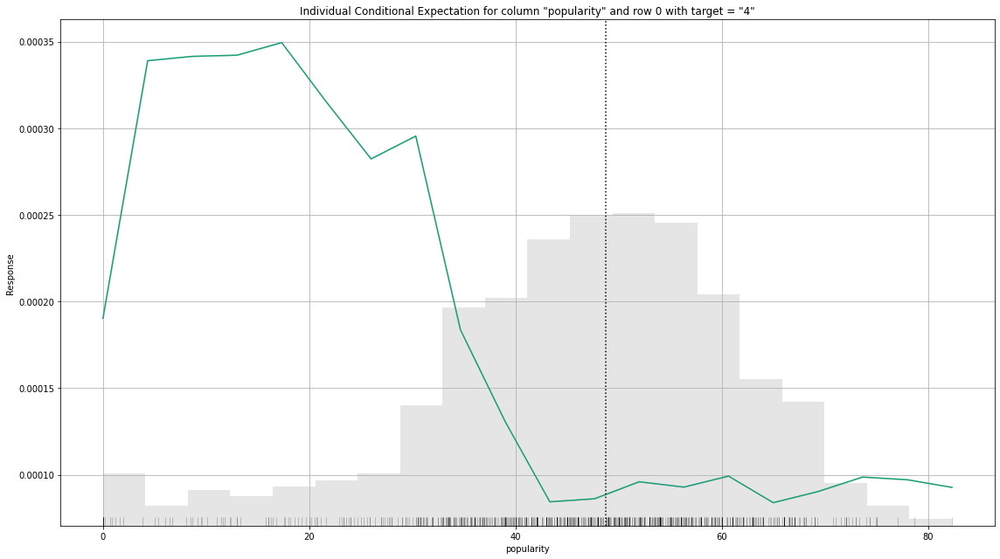

...

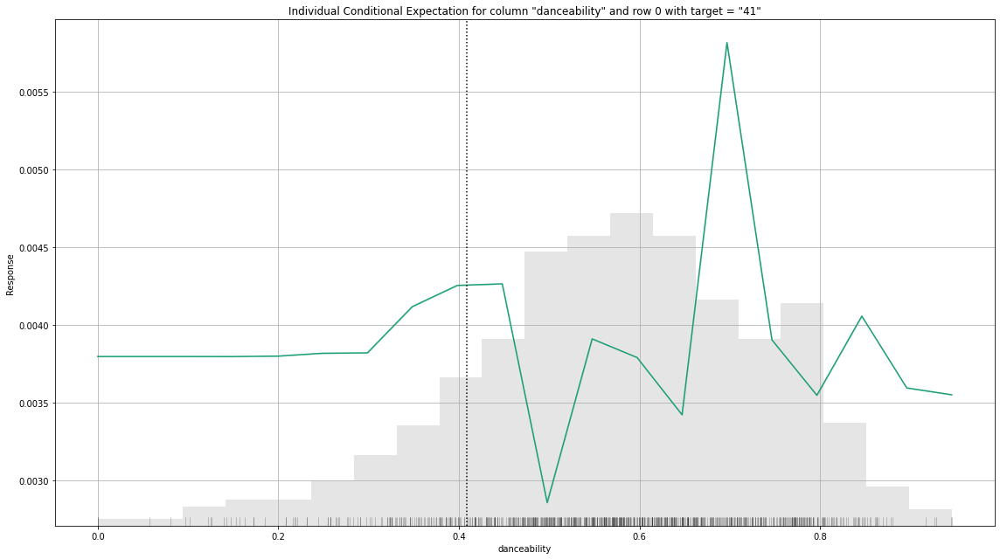

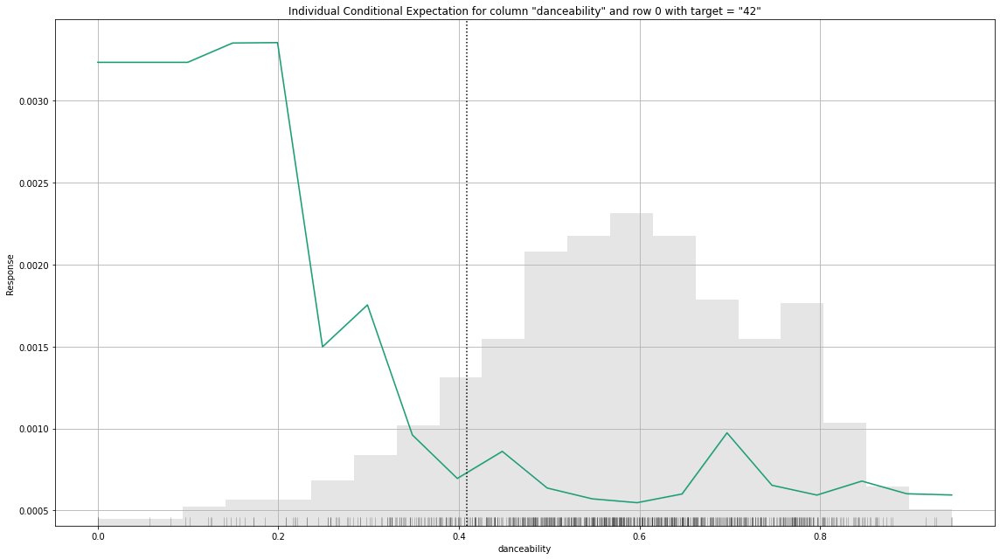

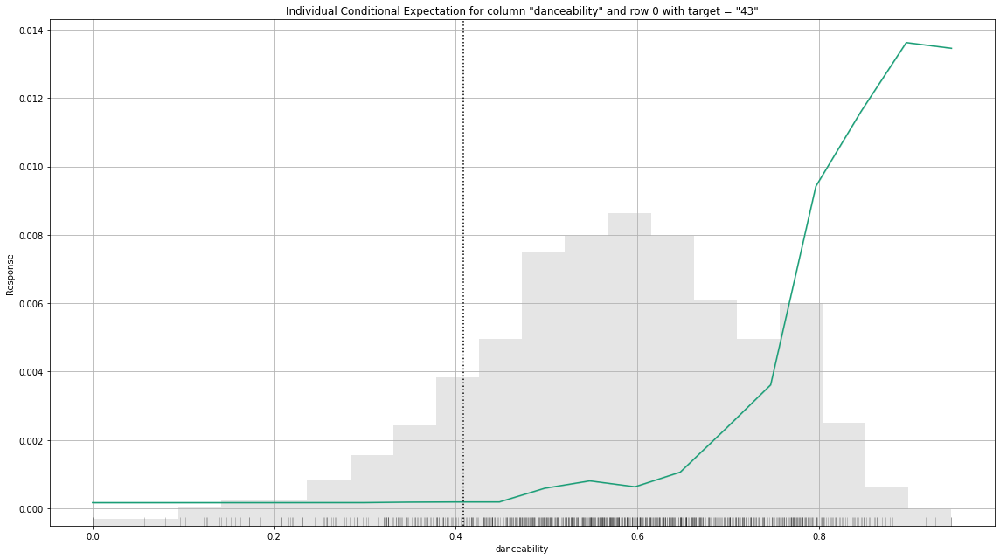

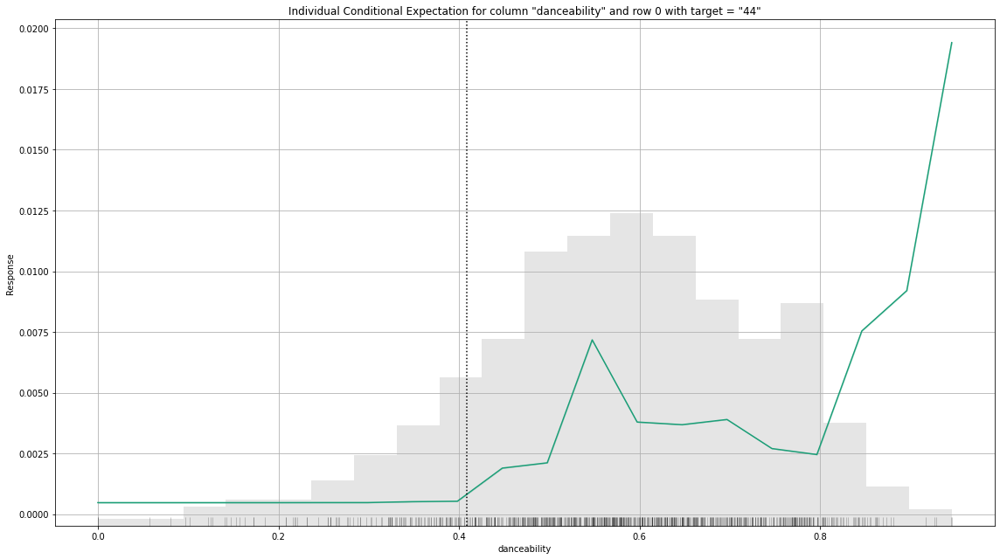

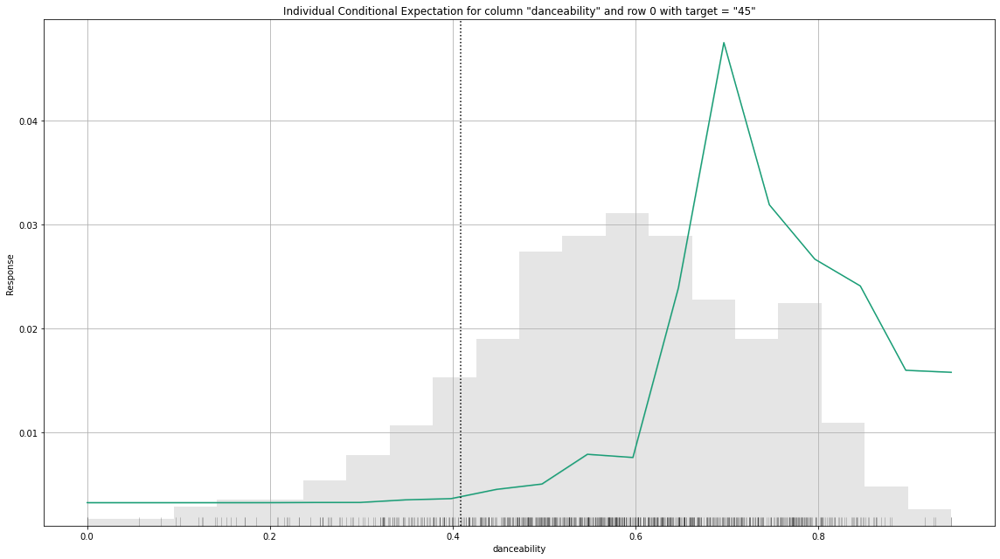

In [29]:
# Descripcion de la prediccion de un ejemplo
best_model.explain_row(test, row_index=0)